#Cas Kaggle: DiagnoseMe: Predictive Symptom2Disease Analysis

## CARLA ARDIACA ROMERO

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import seaborn as sns
import string
from joblib import dump

In [2]:
df = pd.read_csv('Symptom2Disease.csv')
df.head()

,Unnamed: 0,label,text
0,0,Psoriasis,I have been experiencing a skin rash on my arm...
1,1,Psoriasis,"My skin has been peeling, especially on my kne..."
2,2,Psoriasis,I have been experiencing joint pain in my fing...
3,3,Psoriasis,"There is a silver like dusting on my skin, esp..."
4,4,Psoriasis,"My nails have small dents or pits in them, and..."


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  1200 non-null   int64 
 1   label       1200 non-null   object
 2   text        1200 non-null   object
dtypes: int64(1), object(2)
memory usage: 28.2+ KB


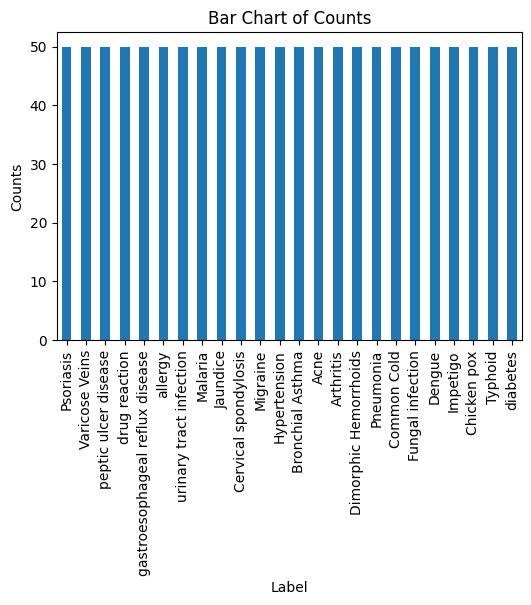

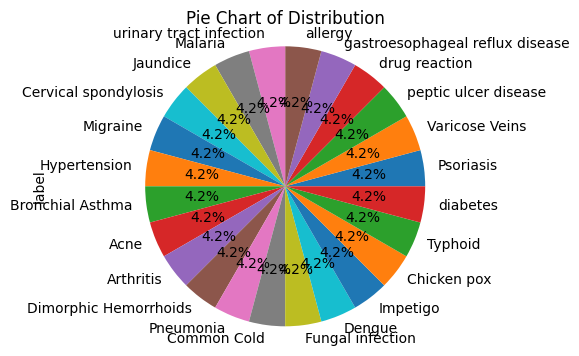

In [4]:
category_counts = df['label'].value_counts()

# Bar chart
plt.figure(figsize=(6, 4))
category_counts.plot(kind='bar')
plt.xlabel('Label')
plt.ylabel('Counts')
plt.title('Bar Chart of Counts')
plt.show()
print()

# Pie chart
plt.figure(figsize=(6, 4))
category_counts.plot(kind='pie', autopct='%1.1f%%')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.title('Pie Chart of Distribution')

plt.show()

In [5]:
duplicate_rows = df[df.duplicated(keep=False)]
df = df.drop_duplicates()

## Comencem netejant les dades:

In [6]:
!pip install nltk

In [7]:
import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [8]:
from nltk.corpus import stopwords
stop_words = (stopwords.words('english'))

In [9]:
text = df['text']
text

0       I have been experiencing a skin rash on my arm...
1       My skin has been peeling, especially on my kne...
2       I have been experiencing joint pain in my fing...
3       There is a silver like dusting on my skin, esp...
4       My nails have small dents or pits in them, and...
                              ...                        
1195    I'm shaking and trembling all over. I've lost ...
1196    Particularly in the crevices of my skin, I hav...
1197    I regularly experience these intense urges and...
1198    I have trouble breathing, especially outside. ...
1199    I constantly sneeze and have a dry cough. My i...
Name: text, Length: 1200, dtype: object

### Fem steeming (ajuntem paraules iguals amb terminacions diferents)

In [10]:
from nltk.stem import PorterStemmer
stemmer = PorterStemmer()

In [11]:
def steeming(df):
    return stemmer.stem(df)

### Tot a minúscules

In [12]:
def convertir_minuscules(df):
    if isinstance(df, str):
      return df.lower()
    else:
       return df.str.lower()

### Eliminem contraccions

In [13]:
contraccions = {"i'm": "i am", "you're": "you are", "he's": "he is", "she's": "she is", "it's": "it is", "we're": "we are", "they're": "they are", "i've": "i have",
                "you've": "you have", "we've": "we have", "they've": "they have", "i'm": "i am", "i'd": "i would", "you'd": "you would", "he'd": "he would",
                "she'd": "she would", "we'd": "we would", "they'd": "they would", "i'll": "i will", "you'll": "you will", "he'll": "he will", "she'll": "she will",
                "we'll": "we will", "they'll": "they will", "don't": "do not", "can't": "can not", "cannot": "can not"
                }

def treure_contraccions(df):
    for paraula in contraccions.keys():
        df = df.replace(paraula, contraccions[paraula])
    return df

### Eliminar signes de puntuació

In [14]:
def eliminar_puntuacio(text):
    result = text.translate(str.maketrans('', '', string.punctuation))
    return result

### Treiem les stopwords (paraules sense significat)

In [15]:
def eliminar_stopwords(text):
  if not isinstance(text, str):
        return text

  paraules = text.split()
  paraules_bones = []

  for par in paraules:
      if par not in stop_words:
          paraules_bones.append(par)

  return ' '.join(paraules_bones)

In [16]:
def netejar_dades(text):
    if not isinstance(text, str):
        return text

    text = steeming(text)
    text = convertir_minuscules(text)
    text = treure_contraccions(text)
    text = eliminar_puntuacio(text)
    text = eliminar_stopwords(text)

    return text

In [17]:
df['text'] = df['text'].apply(netejar_dades)

In [18]:
df

,Unnamed: 0,label,text
0,0,Psoriasis,experiencing skin rash arms legs torso past we...
1,1,Psoriasis,skin peeling especially knees elbows scalp pee...
2,2,Psoriasis,experiencing joint pain fingers wrists knees p...
3,3,Psoriasis,silver like dusting skin especially lower back...
4,4,Psoriasis,nails small dents pits often feel inflammatory...
...,...,...,...
1195,295,diabetes,shaking trembling lost sense taste smell exhau...
1196,296,diabetes,particularly crevices skin skin rashes irritat...
1197,297,diabetes,regularly experience intense urges want urinat...
1198,298,diabetes,trouble breathing especially outside start fee...


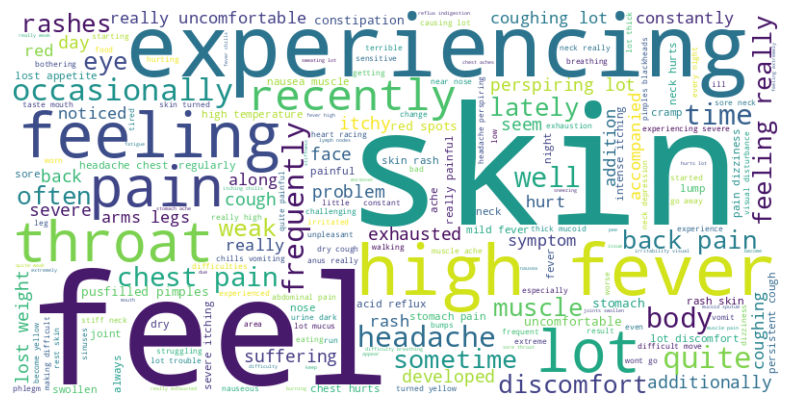

In [19]:
from wordcloud import WordCloud
all_text = " ".join(df["text"])
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [20]:
duplicate_rows = df[df.duplicated(keep=False)]
df = df.drop_duplicates()



---



## Preparem les dades per desprès poder entrenar el model:

### Dividim el test i el train

In [21]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df.drop('label',axis=1),
                                                    df['label'], test_size=0.20,
                                                    random_state=111, stratify= df['label'])
X_test1 = X_test['text']
X_train1= X_train['text']
y_train1= y_train
y_test1 = y_test

In [22]:
LIME = X_test['text']

In [23]:
X_train['text']

593     discovered huge rash skin yesterday face cover...
287     feeling nauseous constant urge vomit accompani...
112     constipation belly pain really uncomfortable p...
259     experiencing muscle pain makes difficult move ...
526     experiencing stiffness weakness neck muscles r...
                              ...                        
519     neck really tight muscles rather weak swelling...
92      walking tough cramps calves obesity believe ca...
1026    mood eat swallowing difficult often lingering ...
782     muscles havent strong experiencing back ache f...
1032    tendency belch burp frequently frequently get ...
Name: text, Length: 960, dtype: object

### Diccionari de les 200 paraules més comunes {word: id}

In [24]:
stop_words_manual = ['also', 'get', 'causing']

In [25]:
def eliminar_par(text):
  paraules = text.split()
  paraules_bones = []

  for par in paraules:
      if par not in stop_words_manual:
          paraules_bones.append(par)

  return ' '.join(paraules_bones)

X_train['text'] = X_train['text'].apply(eliminar_par)
X_train['text']

593     discovered huge rash skin yesterday face cover...
287     feeling nauseous constant urge vomit accompani...
112     constipation belly pain really uncomfortable p...
259     experiencing muscle pain makes difficult move ...
526     experiencing stiffness weakness neck muscles r...
                              ...                        
519     neck really tight muscles rather weak swelling...
92      walking tough cramps calves obesity believe ca...
1026    mood eat swallowing difficult often lingering ...
782     muscles havent strong experiencing back ache f...
1032    tendency belch burp frequently frequently ches...
Name: text, Length: 960, dtype: object

In [26]:
from collections import Counter
paraules_freq = Counter()

for text in X_train['text']:
    paraules_freq.update(text.split())

len(paraules_freq)
print(paraules_freq.most_common(200))

[('skin', 302), ('lot', 287), ('really', 259), ('pain', 250), ('fever', 197), ('feel', 181), ('experiencing', 169), ('feeling', 165), ('high', 165), ('neck', 138), ('chest', 119), ('cough', 118), ('quite', 109), ('throat', 109), ('rash', 107), ('headache', 106), ('hurts', 104), ('body', 99), ('severe', 92), ('itching', 90), ('red', 85), ('weak', 81), ('back', 80), ('painful', 80), ('chills', 78), ('difficult', 74), ('coughing', 72), ('stomach', 71), ('like', 70), ('nausea', 70), ('time', 69), ('go', 69), ('muscles', 68), ('uncomfortable', 67), ('discomfort', 67), ('frequently', 66), ('recently', 65), ('lost', 64), ('legs', 62), ('occasionally', 61), ('trouble', 61), ('additionally', 58), ('breathing', 58), ('rashes', 56), ('vomiting', 55), ('appetite', 55), ('nose', 55), ('addition', 55), ('weight', 55), ('pimples', 54), ('stiff', 54), ('well', 54), ('exhausted', 54), ('itchy', 54), ('joints', 53), ('sores', 53), ('arms', 52), ('yellow', 52), ('swollen', 52), ('night', 51), ('headaches

In [27]:
def tokenizer(paraules_freq):
    tokenizer = {}

    for i, (paraula,_) in enumerate(paraules_freq, start=1):
      tokenizer[paraula] = i
    return tokenizer

In [28]:
tokenizer = tokenizer(paraules_freq.most_common(200))
print(tokenizer)

{'skin': 1, 'lot': 2, 'really': 3, 'pain': 4, 'fever': 5, 'feel': 6, 'experiencing': 7, 'feeling': 8, 'high': 9, 'neck': 10, 'chest': 11, 'cough': 12, 'quite': 13, 'throat': 14, 'rash': 15, 'headache': 16, 'hurts': 17, 'body': 18, 'severe': 19, 'itching': 20, 'red': 21, 'weak': 22, 'back': 23, 'painful': 24, 'chills': 25, 'difficult': 26, 'coughing': 27, 'stomach': 28, 'like': 29, 'nausea': 30, 'time': 31, 'go': 32, 'muscles': 33, 'uncomfortable': 34, 'discomfort': 35, 'frequently': 36, 'recently': 37, 'lost': 38, 'legs': 39, 'occasionally': 40, 'trouble': 41, 'additionally': 42, 'breathing': 43, 'rashes': 44, 'vomiting': 45, 'appetite': 46, 'nose': 47, 'addition': 48, 'weight': 49, 'pimples': 50, 'stiff': 51, 'well': 52, 'exhausted': 53, 'itchy': 54, 'joints': 55, 'sores': 56, 'arms': 57, 'yellow': 58, 'swollen': 59, 'night': 60, 'headaches': 61, 'along': 62, 'urine': 63, 'indigestion': 64, 'often': 65, 'extremely': 66, 'eyes': 67, 'dry': 68, 'anus': 69, 'tired': 70, 'sometimes': 71, 

In [29]:
dump(tokenizer, 'paraules_freq.joblib')

['paraules_freq.joblib']

Subtituïm les paraules del nostre dataset de la columna text per a la id del diccionari tokenizer:

In [30]:
def posar_tokens(text, tokenizer):
    if isinstance(text, str): #si és una sola paraula tracta el text com un string i no el divideixis
        tokens = text.split()
    elif isinstance(text, list): #si és més d'una paraula tracta el text com una llista de paraules
        tokens = text
    linia = []
    for i in tokens:
        linia.append(tokenizer.get(i, 0))
    return linia

In [31]:
X_train['text'] = X_train['text'].apply(lambda x: posar_tokens(x, tokenizer))
X_train['text']

593         [0, 0, 15, 1, 0, 81, 0, 82, 130, 50, 1, 0, 2]
287                  [8, 0, 175, 0, 180, 115, 109, 5, 16]
112            [123, 0, 4, 3, 34, 4, 100, 92, 3, 0, 0, 0]
259     [7, 83, 4, 0, 26, 110, 88, 38, 0, 6, 45, 39, 2...
526     [7, 0, 84, 10, 33, 37, 91, 55, 0, 78, 157, 148...
                              ...                        
519     [10, 3, 0, 33, 0, 22, 162, 55, 0, 78, 110, 148...
92                        [89, 0, 153, 0, 0, 0, 0, 0, 53]
1026    [0, 0, 0, 26, 65, 0, 8, 0, 190, 104, 0, 0, 103...
782         [33, 0, 171, 7, 23, 75, 8, 0, 0, 185, 10, 17]
1032    [0, 0, 0, 36, 36, 11, 4, 0, 0, 0, 23, 10, 0, 0...
Name: text, Length: 960, dtype: object

### Fem padding

In [32]:
def padding(text, max_lenght):
  lines = []
  for lin in text:
    if len(lin) < max_lenght:
      padding = [0] * (max_lenght - len(lin))
      lines.append(lin + padding)
    else:
      lines.append(lin)
  return lines

In [33]:
X_train['text'] = padding(X_train['text'], max(len(seq) for seq in text) )
X_train['text']

593         [0, 0, 15, 1, 0, 81, 0, 82, 130, 50, 1, 0, 2]
287                  [8, 0, 175, 0, 180, 115, 109, 5, 16]
112            [123, 0, 4, 3, 34, 4, 100, 92, 3, 0, 0, 0]
259     [7, 83, 4, 0, 26, 110, 88, 38, 0, 6, 45, 39, 2...
526     [7, 0, 84, 10, 33, 37, 91, 55, 0, 78, 157, 148...
                              ...                        
519     [10, 3, 0, 33, 0, 22, 162, 55, 0, 78, 110, 148...
92                        [89, 0, 153, 0, 0, 0, 0, 0, 53]
1026    [0, 0, 0, 26, 65, 0, 8, 0, 190, 104, 0, 0, 103...
782         [33, 0, 171, 7, 23, 75, 8, 0, 0, 185, 10, 17]
1032    [0, 0, 0, 36, 36, 11, 4, 0, 0, 0, 23, 10, 0, 0...
Name: text, Length: 960, dtype: object

In [34]:
X_train

,Unnamed: 0,text
593,293,"[0, 0, 15, 1, 0, 81, 0, 82, 130, 50, 1, 0, 2]"
287,287,"[8, 0, 175, 0, 180, 115, 109, 5, 16]"
112,112,"[123, 0, 4, 3, 34, 4, 100, 92, 3, 0, 0, 0]"
259,259,"[7, 83, 4, 0, 26, 110, 88, 38, 0, 6, 45, 39, 2..."
526,226,"[7, 0, 84, 10, 33, 37, 91, 55, 0, 78, 157, 148..."
...,...,...
519,219,"[10, 3, 0, 33, 0, 22, 162, 55, 0, 78, 110, 148..."
92,92,"[89, 0, 153, 0, 0, 0, 0, 0, 53]"
1026,126,"[0, 0, 0, 26, 65, 0, 8, 0, 190, 104, 0, 0, 103..."
782,182,"[33, 0, 171, 7, 23, 75, 8, 0, 0, 185, 10, 17]"


### Encoding amb one hot encoding

In [35]:
def one_hot(text, paraules_num):
    one_hot_enc= np.zeros((len(text), paraules_num)) # matriu de zeros

    for i, par in enumerate(text):
        for idx in par:
            if idx > 0 and idx < paraules_num:
                one_hot_enc[i, idx - 1] = 1 #comencen en 1 (per això el = 1)
    return one_hot_enc

In [36]:
encoding_paraules = one_hot(X_train['text'].tolist(), len(tokenizer))
encoding_paraules

array([[1., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [37]:
X_train['text']

593         [0, 0, 15, 1, 0, 81, 0, 82, 130, 50, 1, 0, 2]
287                  [8, 0, 175, 0, 180, 115, 109, 5, 16]
112            [123, 0, 4, 3, 34, 4, 100, 92, 3, 0, 0, 0]
259     [7, 83, 4, 0, 26, 110, 88, 38, 0, 6, 45, 39, 2...
526     [7, 0, 84, 10, 33, 37, 91, 55, 0, 78, 157, 148...
                              ...                        
519     [10, 3, 0, 33, 0, 22, 162, 55, 0, 78, 110, 148...
92                        [89, 0, 153, 0, 0, 0, 0, 0, 53]
1026    [0, 0, 0, 26, 65, 0, 8, 0, 190, 104, 0, 0, 103...
782         [33, 0, 171, 7, 23, 75, 8, 0, 0, 185, 10, 17]
1032    [0, 0, 0, 36, 36, 11, 4, 0, 0, 0, 23, 10, 0, 0...
Name: text, Length: 960, dtype: object

In [38]:
encoding_paraules.shape[0]
df_matriu=pd.DataFrame(encoding_paraules)
df_matriu

,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
956,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
957,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
958,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [39]:
paraules = sorted(tokenizer, key=tokenizer.get)
df_matriu.columns = paraules
df_matriu

,skin,lot,really,pain,fever,feel,experiencing,feeling,high,neck,...,abdomen,experienced,going,restroom,increased,uneasy,losing,concentrate,near,starting
0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
956,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
957,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
958,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [40]:
dump(paraules, 'paraules_dicc.joblib')

['paraules_dicc.joblib']

In [41]:
X_train

,Unnamed: 0,text
593,293,"[0, 0, 15, 1, 0, 81, 0, 82, 130, 50, 1, 0, 2]"
287,287,"[8, 0, 175, 0, 180, 115, 109, 5, 16]"
112,112,"[123, 0, 4, 3, 34, 4, 100, 92, 3, 0, 0, 0]"
259,259,"[7, 83, 4, 0, 26, 110, 88, 38, 0, 6, 45, 39, 2..."
526,226,"[7, 0, 84, 10, 33, 37, 91, 55, 0, 78, 157, 148..."
...,...,...
519,219,"[10, 3, 0, 33, 0, 22, 162, 55, 0, 78, 110, 148..."
92,92,"[89, 0, 153, 0, 0, 0, 0, 0, 53]"
1026,126,"[0, 0, 0, 26, 65, 0, 8, 0, 190, 104, 0, 0, 103..."
782,182,"[33, 0, 171, 7, 23, 75, 8, 0, 0, 185, 10, 17]"


In [42]:
df_matriu["INDEX"]=X_train.index
df_matriu = df_matriu.set_index('INDEX')
X_train = X_train.join(df_matriu)


In [43]:
X_train = X_train.drop(['Unnamed: 0','text'], axis=1)

In [44]:
X_train

,skin,lot,really,pain,fever,feel,experiencing,feeling,high,neck,...,abdomen,experienced,going,restroom,increased,uneasy,losing,concentrate,near,starting
593,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
287,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
112,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
259,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
526,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
519,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
92,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1026,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
782,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Label encoding de les enfermetats (y)

In [45]:
y_train

593                                Acne
287                              Dengue
112                             Typhoid
259                              Dengue
526                           Arthritis
                     ...               
519                           Arthritis
92                       Varicose Veins
1026    gastroesophageal reflux disease
782                Cervical spondylosis
1032    gastroesophageal reflux disease
Name: label, Length: 960, dtype: object

In [46]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(y_train)
y_train[0:5]

array([ 0,  6, 16,  6,  1])

In [47]:
label_noms = {}
for i, label in enumerate(label_encoder.classes_):
    label_noms[label] = i
label_noms

{'Acne': 0,
 'Arthritis': 1,
 'Bronchial Asthma': 2,
 'Cervical spondylosis': 3,
 'Chicken pox': 4,
 'Common Cold': 5,
 'Dengue': 6,
 'Dimorphic Hemorrhoids': 7,
 'Fungal infection': 8,
 'Hypertension': 9,
 'Impetigo': 10,
 'Jaundice': 11,
 'Malaria': 12,
 'Migraine': 13,
 'Pneumonia': 14,
 'Psoriasis': 15,
 'Typhoid': 16,
 'Varicose Veins': 17,
 'allergy': 18,
 'diabetes': 19,
 'drug reaction': 20,
 'gastroesophageal reflux disease': 21,
 'peptic ulcer disease': 22,
 'urinary tract infection': 23}

In [48]:
dump(label_noms, 'label_noms.joblib')

['label_noms.joblib']



---



## Elecció del model:

### Random Forest

In [49]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier

random_state = 153
clf = RandomForestClassifier(random_state=random_state, verbose=False)

param_grid = {
    'n_estimators': [100, 200, 300], #ja provats 100 i 300
    'max_depth': [20, 30, 50, 60, 70, None], #ja provats 10 i 20
    'max_features': ['sqrt', 'log2'],
}

grid_search_clf = GridSearchCV(clf, param_grid, cv=5, scoring = 'f1_weighted')

grid_search_clf.fit(X_train, y_train)

print(grid_search_clf.best_params_)
print(grid_search_clf.best_score_)

{'max_depth': 50, 'max_features': 'log2', 'n_estimators': 300}
0.9366452448050746


In [50]:
dump(grid_search_clf.best_estimator_, 'model_entrenat.joblib')

['model_entrenat.joblib']

### Logistic Regression

In [51]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression(verbose=False, max_iter=1000)

c_values = np.concatenate((np.logspace(-4, 4, 20), np.arange(0.1, 1.0, 0.1)))

param_grid = {
    'C': c_values,
    'fit_intercept': [False,True],
}
grid_search_lr = GridSearchCV(lr, param_grid, cv=5, scoring = 'f1_weighted')
grid_search_lr.fit(X_train,y_train)

print(grid_search_lr.best_params_)
print(grid_search_lr.best_score_)

{'C': 78.47599703514607, 'fit_intercept': True}
0.9271235128104325


### Gradient boosting

In [52]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

gb = GradientBoostingClassifier()

param_grid = {
    'n_estimators': [100, 200, 300],
    #'learning_rate': [0.01, 0.1, 0.2],
}

grid_search_gb = GridSearchCV(gb, param_grid, cv=5, scoring = 'f1_weighted')
grid_search_gb.fit(X_train,y_train)

print(grid_search_gb.best_params_)
print(grid_search_gb.best_score_)

{'n_estimators': 200}
0.9022351069503278


### Naive Bayes Gaussian

In [53]:
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import GridSearchCV

gnb = GaussianNB()

param_grid = {
    'var_smoothing': [1e-2, 1e-6,1e-11, 1e-10, 1e-9]
}

grid_search_gnb = GridSearchCV(gnb, param_grid, cv=5, scoring = 'f1_weighted')
grid_search_gnb.fit(X_train,y_train)

print(grid_search_gnb.best_params_)
print(grid_search_gnb.best_score_)

{'var_smoothing': 0.01}
0.8860750397263555


### Naive Bayes Bernoulli

In [54]:
from sklearn.naive_bayes import BernoulliNB

b_nb = BernoulliNB()

param_grid = {
    'alpha': [1e-2, 1e-3, 0.5, 1],
    'binarize': [0.0, 0.5, 1.0],
    'fit_prior': [True, False],
}

grid_search_b_nb = GridSearchCV(b_nb, param_grid, n_jobs=-1, verbose=False, scoring = 'f1_weighted')
grid_search_b_nb.fit(X_train, y_train)

print(grid_search_b_nb.best_params_)
print(grid_search_b_nb.best_score_)

{'alpha': 0.5, 'binarize': 0.0, 'fit_prior': True}
0.917942021500458




---



## Resultats:

### Preparem les dades del test:

In [55]:
X_test

,Unnamed: 0,text
1091,191,monthly cycle changed unexpected vaginal disch...
4,4,nails small dents pits often feel inflammatory...
875,275,experiencing lot scratching chills vomiting fe...
223,223,rash face become painful inflamed past days so...
199,199,red swollen spots body itches touch moreover a...
...,...,...
52,52,bruising legs explain see strange blood vessel...
159,159,energy lost appetite feeling really sick know ...
66,66,rash legs spreading becoming severe become dif...
1019,119,eating get queasy frequently throw everything ...


In [56]:
X_test['text'] = X_test['text'].apply(lambda x: posar_tokens(x, tokenizer))
X_test['text'] = padding(X_test['text'], 27)
X_test['text']

1091    [0, 0, 0, 0, 0, 0, 40, 0, 0, 0, 0, 2, 0, 0, 0,...
4       [0, 138, 0, 0, 65, 6, 0, 0, 0, 190, 0, 44, 57,...
875     [7, 2, 0, 25, 45, 5, 0, 16, 99, 2, 147, 30, 0,...
223     [15, 81, 80, 24, 168, 0, 87, 56, 0, 0, 0, 0, 1...
199     [21, 59, 86, 18, 0, 0, 0, 0, 9, 5, 16, 158, 6,...
                              ...                        
52      [0, 39, 0, 0, 0, 98, 0, 1, 0, 0, 0, 3, 174, 0,...
159     [0, 38, 46, 8, 3, 125, 0, 0, 0, 0, 0, 0, 0, 0,...
66      [15, 39, 0, 141, 19, 80, 26, 0, 0, 0, 0, 0, 0,...
1019    [107, 0, 0, 36, 0, 0, 0, 158, 0, 19, 144, 75, ...
299     [44, 1, 0, 0, 0, 6, 0, 55, 4, 0, 124, 60, 109,...
Name: text, Length: 240, dtype: object

In [57]:
X_test_encoded = one_hot(X_test['text'].tolist(), len(tokenizer))
X_test_encoded.shape[0]

df_matriu_test=pd.DataFrame(X_test_encoded)
paraules = sorted(tokenizer, key=tokenizer.get)
df_matriu_test.columns = paraules
df_matriu_test["INDEX"]=X_test.index
df_matriu_test = df_matriu_test.set_index('INDEX')
X_test = X_test.join(df_matriu_test)

In [58]:
X_test = X_test.drop(['Unnamed: 0','text'], axis=1)
X_test

,skin,lot,really,pain,fever,feel,experiencing,feeling,high,neck,...,abdomen,experienced,going,restroom,increased,uneasy,losing,concentrate,near,starting
1091,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
875,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
223,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
199,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
159,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [59]:
y_test

1091                      drug reaction
4                             Psoriasis
875                             Malaria
223                            Impetigo
199                         Chicken pox
                     ...               
52                       Varicose Veins
159                         Chicken pox
66                       Varicose Veins
1019    gastroesophageal reflux disease
299                              Dengue
Name: label, Length: 240, dtype: object

In [60]:
y_test=y_test.map(label_noms)
y_test

1091    20
4       15
875     12
223     10
199      4
        ..
52      17
159      4
66      17
1019    21
299      6
Name: label, Length: 240, dtype: int64

### Prediccions amb random forest

In [61]:
from sklearn.metrics import classification_report

y_pred = grid_search_clf.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        10
           1       1.00      1.00      1.00        10
           2       0.91      1.00      0.95        10
           3       1.00      1.00      1.00        10
           4       0.67      0.80      0.73        10
           5       0.91      1.00      0.95        10
           6       1.00      0.70      0.82        10
           7       1.00      1.00      1.00        10
           8       1.00      0.90      0.95        10
           9       1.00      1.00      1.00        10
          10       0.91      1.00      0.95        10
          11       1.00      1.00      1.00        10
          12       1.00      1.00      1.00        10
          13       1.00      1.00      1.00        10
          14       1.00      0.90      0.95        10
          15       1.00      1.00      1.00        10
          16       0.73      0.80      0.76        10
          17       1.00    

### Analitzem els cassos mal classificats

#### Confusion Matrix

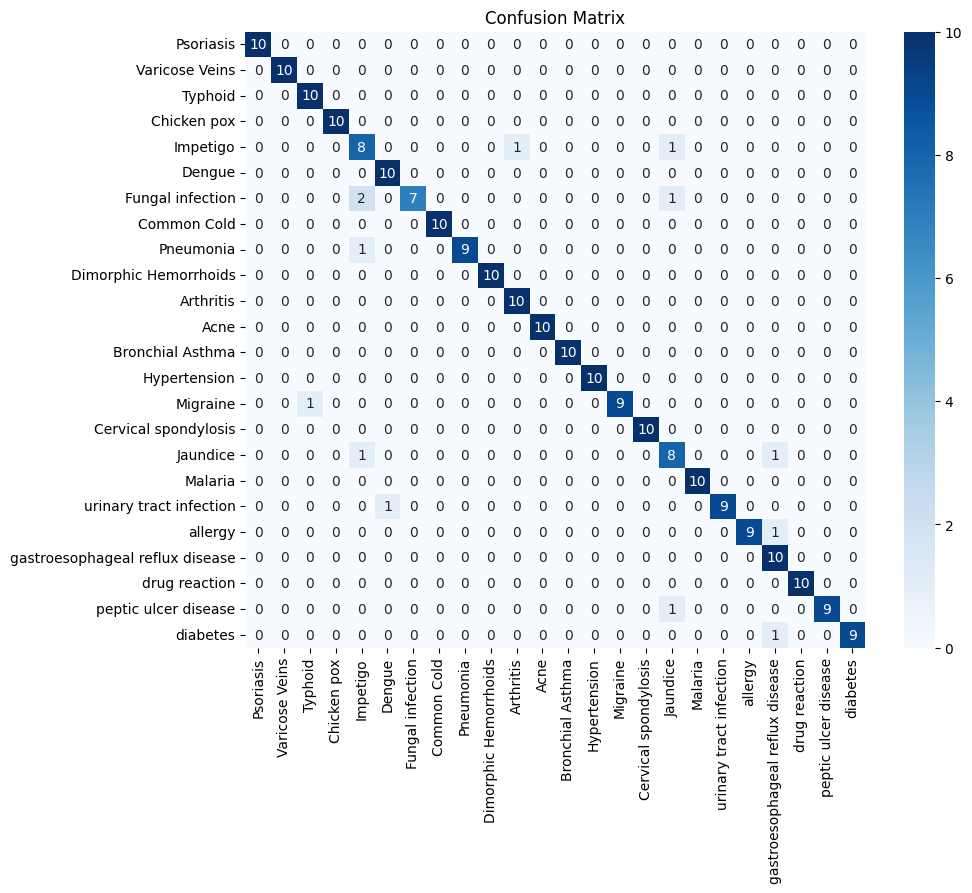

In [62]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=df['label'].unique(), yticklabels=df['label'].unique())
plt.title('Confusion Matrix')
plt.show()

#### Lime Explainability misclassified

In [63]:
!pip install lime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=238f668557c8a2362b2f495b0c55ac9b4885bdecf4b26d6693cdb26968ff762f
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [64]:
mal_classificades = []

for i, (y_test_i, y_pred_i) in enumerate(zip(y_test, y_pred)):
    if y_test_i != y_pred_i:
        mal_classificades.append(i)
mal_classificades

[15, 27, 62, 74, 75, 92, 107, 110, 136, 143, 149, 184, 196]

In [65]:
print(y_pred[7]) #LA QUE JO HE PREDIT
print(y_test.index[7])
print(y_test[1059]) #LA QUE HAURIA DE HAVER DONAT

20
1059
20


In [66]:
nombre_a_numero = {v: k for k, v in label_noms.items()}
predit = y_pred[7]
test = y_test[y_test.index[7]]
print("\033[1m" +"Malatia verdadera: " + "\033[0m",nombre_a_numero[test])
print("\033[1m" +"Malatia predida: "+ "\033[0m", nombre_a_numero[predit])

Malatia verdadera:  drug reaction
Malatia predida:  drug reaction


In [67]:
def padding(token_indices, max_length):
    if len(token_indices) < max_length:
        token_indices += [0] * (max_length - len(token_indices))
    else:
        token_indices = token_indices[:max_length]
    return token_indices

In [68]:
def predict_probaLIME(text_samples):
    all_predictions = []
    for texts in text_samples:
        words = texts.split()
        token_indices = posar_tokens(words, tokenizer)
        padded_indices = padding(token_indices, 27)

        one_hot_enc = np.zeros(len(tokenizer))
        for idx in padded_indices:
            if idx > 0 and idx < len(tokenizer):
                one_hot_enc[idx - 1] = 1

        one_hot_vector_reshaped = one_hot_enc.reshape(1, -1)

        prediction = grid_search_clf.predict_proba(one_hot_vector_reshaped)
        all_predictions.append(prediction[0])

    return np.array(all_predictions)

In [69]:
import warnings
warnings.filterwarnings('ignore')

In [70]:
from lime.lime_text import LimeTextExplainer
noms_classes = label_noms.keys()
explainer = LimeTextExplainer(class_names=noms_classes, verbose=True)

exemple=LIME.loc[1059]

exp = explainer.explain_instance(exemple, predict_probaLIME, num_features=10, top_labels=3)

exp.show_in_notebook(text=True)


Intercept 0.010304385514485592
Prediction_local [0.12484899]
Right: 0.12378409090909093
Intercept 0.12405294331267383
Prediction_local [0.29141521]
Right: 0.2803775962759488
Intercept 0.3001451005096081
Prediction_local [0.29237444]
Right: 0.2939486670838987


In [71]:
nombre_a_numero = {v: k for k, v in label_noms.items()}

for i in mal_classificades:
  predit = y_pred[i]
  test = y_test[y_test.index[i]]
  print("\033[1m" +"Malatia verdadera: " + "\033[0m",nombre_a_numero[test])
  print("\033[1m" +"Malatia predida: "+ "\033[0m", nombre_a_numero[predit])

  malatia = LIME.loc[y_test.index[i]]
  exp = explainer.explain_instance(malatia, predict_probaLIME, num_features=10, top_labels=3)
  exp.show_in_notebook(text=True)
  print()
  print("---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------")
  print()

Malatia verdadera:  diabetes
Malatia predida:  drug reaction
Intercept 0.13989479421302176
Prediction_local [0.20800211]
Right: 0.22736049487222915
Intercept 0.14199952420162182
Prediction_local [0.26546227]
Right: 0.23672317318041963
Intercept 0.2588875862500324
Prediction_local [0.31625526]
Right: 0.3311176491849519



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Chicken pox
Malatia predida:  Typhoid
Intercept 0.02471975518880294
Prediction_local [0.15466627]
Right: 0.15736020923520924
Intercept 0.1358289552331418
Prediction_local [0.22443314]
Right: 0.20742604617604618
Intercept 0.06745918899880038
Prediction_local [0.3571695]
Right: 0.344033189033189



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Chicken pox
Malatia predida:  Impetigo
Intercept 0.05088814847963291
Prediction_local [0.1595598]
Right: 0.15666666666666668
Intercept 0.15777130763531066
Prediction_local [0.23486254]
Right: 0.21333333333333335
Intercept 0.0376898328828251
Prediction_local [0.23218827]
Right: 0.22666666666666666



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Fungal infection
Malatia predida:  Chicken pox
Intercept 0.012948723407414937
Prediction_local [0.09926132]
Right: 0.10666666666666667
Intercept 0.013165810414260126
Prediction_local [0.3171075]
Right: 0.30111111111111116
Intercept 0.15452316304953048
Prediction_local [0.38829736]
Right: 0.3630864197530864



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  allergy
Malatia predida:  Common Cold
Intercept 0.013336841891012259
Prediction_local [0.06512097]
Right: 0.06333333333333334
Intercept 0.07790685621952378
Prediction_local [0.33175061]
Right: 0.3135897435897436
Intercept 0.04076333590229206
Prediction_local [0.3258293]
Right: 0.31694607843137257



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Typhoid
Malatia predida:  drug reaction
Intercept 0.03290758557681647
Prediction_local [0.1334078]
Right: 0.12829575507154706
Intercept 0.047913541493425575
Prediction_local [0.13688986]
Right: 0.13021135265700481
Intercept 0.2929238527099983
Prediction_local [0.18581578]
Right: 0.19368365905537963



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Typhoid
Malatia predida:  Chicken pox
Intercept 0.2463049219185604
Prediction_local [0.08874104]
Right: 0.10136067159678845
Intercept 0.02597367987844766
Prediction_local [0.15356964]
Right: 0.147747337458888
Intercept 0.066663048984773
Prediction_local [0.21944903]
Right: 0.210655758786869



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  urinary tract infection
Malatia predida:  drug reaction
Intercept 0.053181806432102144
Prediction_local [0.11288359]
Right: 0.10823464587994422
Intercept 0.006700035957406161
Prediction_local [0.11252382]
Right: 0.12159414437765054
Intercept 0.3059536173559477
Prediction_local [0.18105483]
Right: 0.18301222597448882



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Pneumonia
Malatia predida:  Bronchial Asthma
Intercept 0.008728062058258379
Prediction_local [0.0909872]
Right: 0.08666666666666667
Intercept 0.037458438824815005
Prediction_local [0.23103413]
Right: 0.22333333333333333
Intercept 0.027608345970094428
Prediction_local [0.51689693]
Right: 0.5004761904761904



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  peptic ulcer disease
Malatia predida:  Typhoid
Intercept 0.2938290681546111
Prediction_local [0.15114185]
Right: 0.15470812154479105
Intercept 0.12389386790661847
Prediction_local [0.24942293]
Right: 0.23630354525192393
Intercept 0.008986985088650506
Prediction_local [0.24060816]
Right: 0.24251335155482934



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Dengue
Malatia predida:  Chicken pox
Intercept 0.012273911026324094
Prediction_local [0.17649373]
Right: 0.16666666666666666
Intercept 0.02839945783908779
Prediction_local [0.25095558]
Right: 0.25
Intercept 0.10731084443003018
Prediction_local [0.26525759]
Right: 0.2509500805152979



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Dengue
Malatia predida:  Typhoid
Intercept 0.0632758505894293
Prediction_local [0.14096412]
Right: 0.12666666666666668
Intercept 0.10533394906800074
Prediction_local [0.17005666]
Right: 0.16006172839506172
Intercept 0.02160787758869609
Prediction_local [0.28674394]
Right: 0.2835185185185185



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Malatia verdadera:  Dengue
Malatia predida:  Chicken pox
Intercept 0.24529510487558379
Prediction_local [0.13584117]
Right: 0.1219047619047619
Intercept 0.058915070688015436
Prediction_local [0.30618129]
Right: 0.29
Intercept 0.06145643847397242
Prediction_local [0.41523643]
Right: 0.4166666666666667



---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



#### Lime Explainability good classified examples:

In [72]:
predit = y_pred[0]
test = y_test[y_test.index[0]]
print("\033[1m" +"Malatia verdadera: " + "\033[0m",nombre_a_numero[test])
print("\033[1m" +"Malatia predida: "+ "\033[0m", nombre_a_numero[predit])

malatia = LIME.loc[y_test.index[0]]
exp = explainer.explain_instance(malatia, predict_probaLIME, num_features=10, top_labels=3)
exp.show_in_notebook(text=True)

Malatia verdadera:  drug reaction
Malatia predida:  drug reaction
Intercept 0.19476176235456039
Prediction_local [0.1233604]
Right: 0.12296478104497514
Intercept 0.13451260410770544
Prediction_local [0.15649173]
Right: 0.1575679326802511
Intercept 0.3210416060840311
Prediction_local [0.37089885]
Right: 0.36742463571706724


In [73]:
predit = y_pred[80]
test = y_test[y_test.index[80]]
print("\033[1m" +"Malatia verdadera: " + "\033[0m",nombre_a_numero[test])
print("\033[1m" +"Malatia predida: "+ "\033[0m", nombre_a_numero[predit])

malatia = LIME.loc[y_test.index[80]]
exp = explainer.explain_instance(malatia, predict_probaLIME, num_features=10, top_labels=3)
exp.show_in_notebook(text=True)

Malatia verdadera:  Psoriasis
Malatia predida:  Psoriasis
Intercept 0.016942165033670707
Prediction_local [0.03398637]
Right: 0.03181149425287357
Intercept 0.25657254019341835
Prediction_local [0.05455281]
Right: 0.06294523963886783
Intercept 0.10189637177736116
Prediction_local [0.77996498]
Right: 0.7630648586903459


In [74]:
predit = y_pred[115]
test = y_test[y_test.index[115]]
print("\033[1m" +"Malatia verdadera: " + "\033[0m",nombre_a_numero[test])
print("\033[1m" +"Malatia predida: "+ "\033[0m", nombre_a_numero[predit])

malatia = LIME.loc[y_test.index[115]]
exp = explainer.explain_instance(malatia, predict_probaLIME, num_features=10, top_labels=3)
exp.show_in_notebook(text=True)

Malatia verdadera:  Bronchial Asthma
Malatia predida:  Bronchial Asthma
Intercept 0.06352126944342264
Prediction_local [0.01914327]
Right: 0.016666666666666666
Intercept 0.09948825661328187
Prediction_local [0.04475812]
Right: 0.023333333333333334
Intercept -0.06277281946582225
Prediction_local [0.91260975]
Right: 0.91


In [75]:
predit = y_pred[150]
test = y_test[y_test.index[150]]
print("\033[1m" +"Malatia verdadera: " + "\033[0m",nombre_a_numero[test])
print("\033[1m" +"Malatia predida: "+ "\033[0m", nombre_a_numero[predit])

malatia = LIME.loc[y_test.index[150]]
exp = explainer.explain_instance(malatia, predict_probaLIME, num_features=10, top_labels=3)
exp.show_in_notebook(text=True)

Malatia verdadera:  Varicose Veins
Malatia predida:  Varicose Veins
Intercept 0.2818642676613623
Prediction_local [0.11509978]
Right: 0.12352924736269685
Intercept 0.10639157982767256
Prediction_local [0.30505106]
Right: 0.2873465938179721
Intercept 0.08545790232533615
Prediction_local [0.3602864]
Right: 0.3755474641796579


In [76]:
warnings.filterwarnings('default')

### TOP 3 accuracy

In [77]:
p = grid_search_clf.predict_proba(X_test) #PREDIR LES 3 CLASSES MÉS PROBABLES
top_classes = np.argsort(p, axis=1)[:, -3:]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [78]:
top_classes_probabilities = np.array([probabilitats[i] for probabilitats, i in zip(p, top_classes)])


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [79]:
bones=0
mal_classificadesTOP3  = []
for i, (y_bona, y_predida) in enumerate(zip(y_test, top_classes)):
    if y_bona in y_predida:
        bones += 1
    else:
      print(i)
      mal_classificadesTOP3.append(y_test.index[i])
      print(y_bona)
      print(y_predida)

107
16
[20  6  4]
110
23
[15 16 20]


In [80]:
mal_classificadesTOP3

[117, 916]

In [81]:
print(y_test.index[110])
print(top_classes_probabilities[110])
print(top_classes[110])

916
[0.10823465 0.12159414 0.18301223]
[15 16 20]


In [82]:
accuracy = bones/len(y_pred)
accuracy

0.9916666666666667

In [83]:
y_test.index[110]

916

In [84]:
import warnings
warnings.filterwarnings('ignore')

In [85]:
from lime.lime_text import LimeTextExplainer
noms_classes = label_noms.keys()

In [86]:
nombre_a_numero = {v: k for k, v in label_noms.items()}
predit = y_pred[107]
test = y_test[y_test.index[107]]
print("\033[1m" +"Malatia verdadera: " + "\033[0m",nombre_a_numero[test])
print("\033[1m" +"Malatia predida: "+ "\033[0m", nombre_a_numero[predit])

malatia = LIME.loc[y_test.index[107]]
exp = explainer.explain_instance(malatia, predict_probaLIME, num_features=10, top_labels=5)
exp.show_in_notebook(text=True)

Malatia verdadera:  Typhoid
Malatia predida:  Chicken pox
Intercept 0.12397873521602945
Prediction_local [0.10511852]
Right: 0.09566304301446307
Intercept 0.05216268900910297
Prediction_local [0.10379439]
Right: 0.0976280193236715
Intercept 0.24423660017374277
Prediction_local [0.08928615]
Right: 0.10136067159678845
Intercept 0.026764717844997565
Prediction_local [0.15346729]
Right: 0.147747337458888
Intercept 0.06768410871021531
Prediction_local [0.21891771]
Right: 0.210655758786869


In [87]:
nombre_a_numero = {v: k for k, v in label_noms.items()}
predit = y_pred[110]
test = y_test[y_test.index[110]]
print("\033[1m" +"Malatia verdadera: " + "\033[0m",nombre_a_numero[test])
print("\033[1m" +"Malatia predida: "+ "\033[0m", nombre_a_numero[predit])

malatia = LIME.loc[y_test.index[110]]
exp = explainer.explain_instance(malatia, predict_probaLIME, num_features=10, top_labels=5)
exp.show_in_notebook(text=True)

Malatia verdadera:  urinary tract infection
Malatia predida:  drug reaction
Intercept 0.13295237210890518
Prediction_local [0.10035605]
Right: 0.1060569344048798
Intercept 0.20243141828829517
Prediction_local [0.11876457]
Right: 0.10760783378662048
Intercept 0.0530454658970349
Prediction_local [0.1130249]
Right: 0.10823464587994422
Intercept 0.006896285727355976
Prediction_local [0.11229103]
Right: 0.12159414437765054
Intercept 0.3060403038021574
Prediction_local [0.18097744]
Right: 0.18301222597448882


In [88]:
warnings.filterwarnings('default')

### TOP 5 accuracy

In [89]:
p = grid_search_clf.predict_proba(X_test) #PREDIR LES 5 CLASSES MÉS PROBABLES
top_classes = np.argsort(p, axis=1)[:, -5:]
print(top_classes)

[[23 22 19 17 20]
 [ 4  6 20 19 15]
 [ 9 19  6 16 12]
 ...
 [ 6 15 20 10 17]
 [16 20 22 13 21]
 [10  4 16 15  6]]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [90]:
top_classes_probabilities = np.array([probabilitats[i] for probabilitats, i in zip(p, top_classes)])

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [91]:
top_classes_probabilities

array([[0.04993684, 0.06678084, 0.12296478, 0.15756793, 0.36742464],
       [0.09877095, 0.11237496, 0.15290284, 0.15342141, 0.27632763],
       [0.01019608, 0.01173611, 0.02      , 0.08130719, 0.81      ],
       ...,
       [0.04354632, 0.07466361, 0.08076142, 0.11370608, 0.58830452],
       [0.07112285, 0.09569686, 0.14634713, 0.18097599, 0.32144184],
       [0.07666667, 0.09030303, 0.2269697 , 0.23121212, 0.23356061]])

In [92]:
bones=0
for y_bona, y_predida in zip(y_test, top_classes):
    if y_bona in y_predida:
        bones += 1

In [93]:
accuracy = bones/len(y_pred)
accuracy

0.9958333333333333